## Семинар 6: "Детекция объектов на изображении"

ФИО:

## Цель задания:
Научиться самостоятельно решать задачу детекции.
## Описание задания:
В рамках данного домашнего задания предлагается решить задачу детекции мячей и настроить полный пайплайн обучения модели.

Процесс выполнения задания следующий:

0. Выбор модели детекции для обучения:
    1. Выберите модель детекции для выполнения домашнего задания. Любую, кроме RetinaNet. Ее реализацию можно взять из открытых источников. Модель можно брать предобученную ( в этом случае в пункте 4. показать влияние предобучения на финальное качество).
    2. Полезные ссылки: [PyTorch Vision Models](https://pytorch.org/vision/stable/models.html) (блок Object Detection), [SOTA модели детекции](https://paperswithcode.com/sota/object-detection-on-coco), [Возможный пример кода](https://github.com/AlekseySpasenov/dl-course/blob/autumn_2023/lecture8/detection_example/pytorch_detection_workshop.ipynb)

1. Подготовка обучающего набора данных
    1. Реализуйте корректный класс Dataset и Dataloader для выбранной модели (должен работать форвард вашей модели на том, что выходит из даталоадера) **0.5 балла**.
    2. Добавьте простые аугментации в датасет (аугментации, не затрагивающие изменение ground-truth bounding box) **0.5 балла**.
    3. Внедрите сложные аугментации (аугментации, затрагивающие изменение ground-truth bounding box. Например, аффинные преобразования: сдвиг, поворот и т.д.) **0.5 балла**.

    4. Полезные ссылки: https://pytorch.org/vision/stable/transforms.html , https://albumentations.ai

2. Реализация корректного train-loop и обучение модели:  
    1. Реализуйте эффективный train-loop для вашей модели и проведите обучение **2 балла**.
    2. Выполните несколько запусков обучения с различными параметрами, например: сравните влияние различных аугментаций, оцените влияние того была предобучена модель или нет, сравните результаты при изменении гиперпараметров итд (на ваш выбор) **0.5 балла**.

3. Валидация обученных моделей на тестовой выборке, вычисление метрики mAP
    1. Оцените качество моделей на тестовой части данных и рассчитайте метрику mAP **0.5 балл**
    2. Полезные ссылки: [mean_average_precision](https://github.com/bes-dev/mean_average_precision)

4. Выводы **0.5 балл**:
    1. Проанализируйте результаты обучения, визуально оцените качество работы модели.
    2. Прокомментируйте распространенные ошибки модели и предложите пути для улучшения финального решения.

## Срок выполнения задания:
Данное задание можно сдать без штрафов до 4 марта.


In [ ]:
# from google.colab import drive
# drive.mount("/content/drive")a

In [ ]:
# !unzip /content/drive/MyDrive/nn_hse/seminar_objdet_retina_oi5_ball.zip -d /content/ball_data

In [1]:
!pip install albumentations

In [1]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import json
import albumentations as A

device = "cuda" if torch.cuda.is_available() else "cpu"
print("Device is:", device)

Device is: cuda


In [2]:
def show_image(image, figsize=(10, 10)):
    plt.figure(figsize=figsize)
    plt.imshow(image)
    plt.axis("off")
    plt.show()

(198, 333) (238, 377)
(346, 357) (390, 402)
(384, 333) (424, 374)
(392, 308) (430, 331)
(470, 315) (507, 351)
(600, 295) (632, 326)


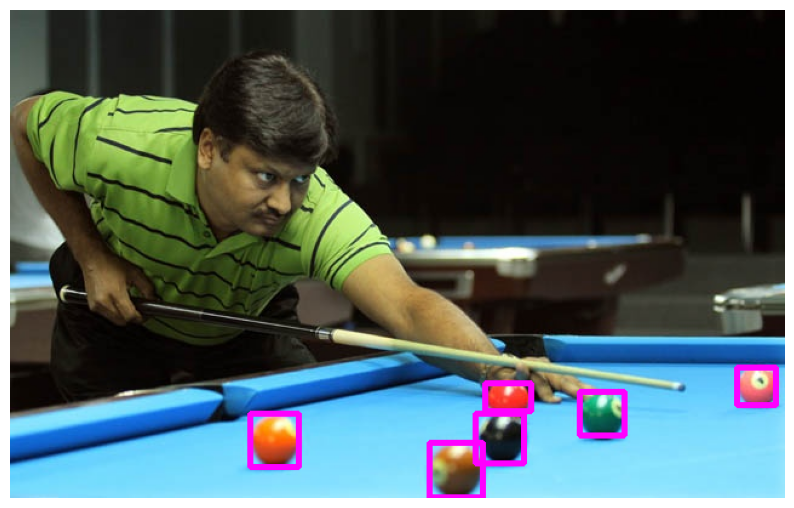

In [3]:
with open("/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_train.json", "r") as f:
    bboxes_dict = json.load(f)

test_image = cv2.imread("/kaggle/input/oi5-ball/oi5_ball/0256.jpg")
test_bbox = bboxes_dict['oi5_ball/0256.jpg']
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255

imageRectangle = test_image.copy()

h, w = imageRectangle.shape[:2]

for item in test_bbox:
    x1 = int(item[0] * w)
    x2 = int(item[1] * w)
    y1 = int(item[2] * h)
    y2 = int(item[3] * h)
    print((x1, y1), (x2, y2))
    color = (255, 0, 255)
    thickness = 3

    cv2.rectangle(imageRectangle, (x1, y1), (x2, y2), color, thickness)


show_image(imageRectangle)

In [4]:
a = {'oi5_ball/0256.jpg': [1, 2, 3, 4]}
for i,j in a.items():
    print(j)
    print('asdf' + i)

[1, 2, 3, 4]
asdfoi5_ball/0256.jpg


In [5]:
from PIL import Image, ImageDraw

class BallsDataset(torch.utils.data.Dataset):
    def __init__(self, bbox_dict_file,
                 transforms=None,
                 augment=False,
                 add_path=None):

        self.transforms = transforms
        self.augment = augment

        with open(bbox_dict_file, 'r') as f:
            self.bbox_dict = json.load(f)

        if add_path:
            self.bbox_dict = {add_path + path: value for path, value in self.bbox_dict.items()}

        self.imgs = list(self.bbox_dict.keys())

    def __len__(self):
        return len(self.imgs)

    def __getitem__(self, idx):
        img_path = self.imgs[idx]
        image = Image.open(img_path).convert("RGB")
        # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255

        w, h = image.size

        bboxes = []
        labels = []

        for bbox in self.bbox_dict[img_path]:
            xmin = int(bbox[0] * w)
            xmax = int(bbox[1] * w)
            ymin = int(bbox[2] * h)
            ymax = int(bbox[3] * h)

            bboxes.append([xmin, ymin, xmax, ymax])


        num_objs = len(self.bbox_dict[img_path])

        

        # image = torch.from_numpy(image).permute(2, 0, 1).to(torch.float)

        if self.transforms:
            image = self.transforms(image)
        
        bboxes = torch.FloatTensor(bboxes)
        labels = torch.ones((num_objs,), dtype=torch.int64)
            

        target = {'boxes': bboxes,
                  'labels': labels,
                  'image_id': torch.tensor([idx])}

        return image, target


In [6]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [ ]:
from torchvision import transforms

img_transforms = transforms.Compose([
    transforms.ToTensor()
])

train_dataset = BallsDataset('/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_train.json',
                             add_path='/kaggle/input/oi5-ball/',
                             transforms=img_transforms)

val_dataset = BallsDataset('/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_val.json',
                             add_path='/kaggle/input/oi5-ball/',
                             transforms=img_transforms)



train_data_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    collate_fn=collate_fn
)

val_data_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=4,
    shuffle=False,
    collate_fn=collate_fn
)

**Обучение предобученной модели без аугментаций**

In [ ]:
# model = fasterrcnn_resnet50_fpn_v2(num_classes=1)

model_pretrained = fasterrcnn_resnet50_fpn_v2(pretrained=True)
in_features = model_pretrained.roi_heads.box_predictor.cls_score.in_features
model_pretrained.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)

optimizer = torch.optim.Adam(model_pretrained.parameters(), lr=1e-4, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.9)

model_pretrained.to(device)

In [87]:
import tqdm

def train_loop(model, optimizer, data_loader):
    model.train()
    epoch_loss = 0
    for images, targets in tqdm.tqdm(data_loader):
        optimizer.zero_grad()
        # images, targets = data[0], data[1]
        images = [image.to(device) for image in images]
        
        targets = [{key: value.to(device) for key, value in target.items()} for target in targets]
        loss_dict = model(images, targets)
        loss = sum(loss for loss in loss_dict.values())
        epoch_loss += loss.item()
        loss.backward()
        optimizer.step()
        # if i % 50 == 0:
            # print(f"iteration {i} loss: {loss}")

    train_loss = epoch_loss / len(data_loader.dataset)
    return train_loss

def val_loop(model, optimizer, data_loader):
    epoch_loss = 0
    for images, targets in tqdm.tqdm(data_loader):
        optimizer.zero_grad()
        images = [image.to(device) for image in images]
        targets = [{key: value.to(device) for key, value in target.items()} for target in targets]
        with torch.no_grad():
            loss_dict = model(images, targets)

        loss = sum(loss for loss in loss_dict.values())
        epoch_loss += loss.item()

    val_loss = epoch_loss / len(data_loader.dataset)
    return val_loss

In [86]:
num_epochs = 10
for i in range(num_epochs):
    train_loss = train_loop(model_pretrained, optimizer, train_data_loader)
    print(f'train loss: {train_loss}')
# val_loop(model, optimizer, val_data_loader)

  0%|          | 0/719 [00:00<?, ?it/s]

torch.Size([3, 683, 1024])
4


  0%|          | 1/719 [00:02<31:18,  2.62s/it]

torch.Size([3, 1024, 731])
4


  0%|          | 2/719 [00:03<18:21,  1.54s/it]

torch.Size([3, 683, 1024])
4


  0%|          | 3/719 [00:04<13:48,  1.16s/it]

torch.Size([3, 683, 1024])
4


  0%|          | 3/719 [00:04<19:08,  1.60s/it]


KeyboardInterrupt: 

In [ ]:
torch.save(model_pretrained.state_dict(), 'model_ptretrained_without_aug.pth')

**Обучение модели без претрейна и без аугментаций**

In [78]:
model_without_pretrained = fasterrcnn_resnet50_fpn_v2(pretrained=False)
in_features = model_without_pretrained.roi_heads.box_predictor.cls_score.in_features
model_without_pretrained.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)

optimizer = torch.optim.Adam(model_without_pretrained.parameters(), lr=1e-4, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.9)

model_without_pretrained.to(device)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [9]:
train_data_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=2,
    shuffle=True,
    collate_fn=collate_fn
)

val_data_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=2,
    shuffle=False,
    collate_fn=collate_fn
)

In [12]:
num_epochs = 10
for i in range(num_epochs):
    train_loss = train_loop(model_without_pretrained, optimizer, train_data_loader)
    print(f'train loss: {train_loss}')

100%|██████████| 1438/1438 [11:11<00:00,  2.14it/s]


train loss: 0.146795443913211


100%|██████████| 1438/1438 [11:09<00:00,  2.15it/s]


train loss: 0.13792586676970772


100%|██████████| 1438/1438 [11:11<00:00,  2.14it/s]


train loss: 0.1335249971980634


100%|██████████| 1438/1438 [11:13<00:00,  2.14it/s]


train loss: 0.12673423015941745


100%|██████████| 1438/1438 [11:15<00:00,  2.13it/s]


train loss: 0.1238532195467016


100%|██████████| 1438/1438 [11:15<00:00,  2.13it/s]


train loss: 0.11734841662904491


100%|██████████| 1438/1438 [11:17<00:00,  2.12it/s]


train loss: 0.1153064128730608


100%|██████████| 1438/1438 [11:12<00:00,  2.14it/s]


train loss: 0.11132217312118281


100%|██████████| 1438/1438 [11:12<00:00,  2.14it/s]


train loss: 0.10779249647778014


100%|██████████| 1438/1438 [11:16<00:00,  2.13it/s]

train loss: 0.10611869800220365


In [13]:
torch.save(model_without_pretrained.state_dict(), 'model_not_ptretrained_without_aug.pth')

In [ ]:
!pip install mean_average_precision

In [ ]:
# model.load_state_dict(torch.load('/kaggle/input/io5_fastrcnn_4epoch/pytorch/1/1/model_state_dict_workshop_final (1).pth'))

**Обучение с аугментациями**

In [7]:
from torchvision.transforms import ToTensor

class BallsDataset(torch.utils.data.Dataset):
    def __init__(self, bbox_dict_file,
                 transforms=None,
                 augment=False,
                 add_path=None):

        self.transforms = transforms
        self.augment = augment
        self.im_transform = ToTensor()


        with open(bbox_dict_file, 'r') as f:
            self.bbox_dict = json.load(f)

        if add_path:
            self.bbox_dict = {add_path + path: value for path, value in self.bbox_dict.items()}

        self.imgs = list(self.bbox_dict.keys())

    def __len__(self):
        return len(self.imgs)

    def __getitem__(self, idx):
        img_path = self.imgs[idx]
#         image = Image.open(img_path).convert("RGB")
        image = plt.imread(img_path)
#         image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255
        
        w, h = image.shape[:2]
        
        bboxes = []
        labels = []

        for bbox in self.bbox_dict[img_path]:
            xmin = int(bbox[0] * w)
            xmax = int(bbox[1] * w)
            ymin = int(bbox[2] * h)
            ymax = int(bbox[3] * h)

            bboxes.append([xmin, ymin, xmax, ymax])


        num_objs = len(self.bbox_dict[img_path])

        

        # image = torch.from_numpy(image).permute(2, 0, 1).to(torch.float)
        
        if self.transforms:
            try:
                transformed = self.transforms(image=image, bboxes=bboxes, class_labels=labels)

                image = transformed['image']
                bboxes = transformed['bboxes']
                labels = transformed['class_labels']
            except Exception as ex:
                pass
        
        image = self.im_transform(image)
        bboxes = torch.FloatTensor(bboxes)
        labels = torch.ones((num_objs,), dtype=torch.int64)
            

        target = {'boxes': bboxes,
                  'labels': labels,
                  'image_id': torch.tensor([idx])}

        return image, target


In [8]:
from torchvision import transforms

img_transforms = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.Rotate(limit=15)
], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']))

train_dataset = BallsDataset('/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_train.json',
                             add_path='/kaggle/input/oi5-ball/',
                             transforms=img_transforms)

val_dataset = BallsDataset('/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_val.json',
                             add_path='/kaggle/input/oi5-ball/',
                             transforms=img_transforms)



train_data_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=4,
    shuffle=True,
    collate_fn=collate_fn
)

val_data_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=4,
    shuffle=False,
    collate_fn=collate_fn
)

In [8]:
# model = fasterrcnn_resnet50_fpn_v2(num_classes=1)

model_with_aug = fasterrcnn_resnet50_fpn_v2(pretrained=True)
in_features = model_with_aug.roi_heads.box_predictor.cls_score.in_features
model_with_aug.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)

optimizer = torch.optim.Adam(model_with_aug.parameters(), lr=1e-4, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=0.9)

model_with_aug.to(device)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_V2_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth
100%|██████████| 167M/167M [00:02<00:00, 65.5MB/s] 


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [9]:
from tqdm.notebook import tqdm

def train_loop(model, optimizer, data_loader):
    model.train()
    epoch_loss = 0
    for images, targets in tqdm(data_loader):
        optimizer.zero_grad()
        # images, targets = data[0], data[1]
        images = [image.to(device) for image in images]
        targets = [{key: value.to(device) for key, value in target.items()} for target in targets]
        loss_dict = model(images, targets)
        loss = sum(loss for loss in loss_dict.values())
        epoch_loss += loss.item()
        loss.backward()
        optimizer.step()
        # if i % 50 == 0:
            # print(f"iteration {i} loss: {loss}")

    train_loss = epoch_loss / len(data_loader.dataset)
    return train_loss

def val_loop(model, optimizer, data_loader):
    epoch_loss = 0
    for images, targets in tqdm(data_loader):
        optimizer.zero_grad()
        images = [image.to(device) for image in images]
        targets = [{key: value.to(device) for key, value in target.items()} for target in targets]
        with torch.no_grad():
            loss_dict = model(images, targets)

        loss = sum(loss for loss in loss_dict.values())
        epoch_loss += loss.item()

    val_loss = epoch_loss / len(data_loader.dataset)
    return val_loss

In [10]:
num_epochs = 10
for i in range(num_epochs):
    train_loss = train_loop(model_with_aug, optimizer, train_data_loader)
    print(f'train loss: {train_loss}')

  0%|          | 0/719 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/torchvision/transforms/functional.py:152: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at /usr/local/src/pytorch/torch/csrc/utils/tensor_numpy.cpp:206.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


train loss: 0.10756547701877096


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.0936619800173718


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.08966552774932074


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.08991931197047233


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.09613027609560801


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.08474352378948875


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.09824406489341156


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.08633396904753603


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.09715442900035692


  0%|          | 0/719 [00:00<?, ?it/s]

train loss: 0.08377858855413355


In [12]:
torch.save(model_with_aug.state_dict(), 'model_ptretrained_with_aug.pth')

**mAP для предобученной модели**

In [16]:
!pip install mean_average_precision

In [23]:
from mean_average_precision import MetricBuilder
from tqdm.notebook import tqdm



def compute_mAP(data_loader, model, treshold=0.5):
    metric_fn = MetricBuilder.build_evaluation_metric("map_2d", async_mode=True, num_classes=1)
    
    for images, targets in tqdm(data_loader):
        model.eval()

        images = [image.to(device) for image in images]


        with torch.no_grad():
            predictions = model(images)


        for pred, target in zip(predictions, targets):
            true_bboxes = target['boxes'].numpy()
            class_id = np.zeros(len(target['boxes']))[:, None]
            difficult = np.zeros(len(target['boxes']))[:, None]
            crowd = np.zeros(len(target['boxes']))[:, None]

            pred_bbox = pred['boxes'].to('cpu').numpy()
            pred_labels = np.zeros(len(pred['labels']))[:, None]
            pred_scores = pred['scores'].to('cpu').numpy()[:, None]

            gt = np.hstack([true_bboxes, class_id, difficult, crowd])
            gt = np.array([item.tolist() for item in gt])
            preds = np.hstack([pred_bbox, pred_labels, pred_scores])
            preds = np.array([item.tolist() for item in preds])

            metric_fn.add(preds, gt)
    return metric_fn.value(iou_thresholds=treshold)['mAP']
    
# compute_mAP(val_data_loader, model_pretrained)

**Сравним на изображениях реальных боксы с предсказанными, которые мы отсеиваем с определенным трешхолдом. Для модели с претрейн бекбоун**

In [18]:
import seaborn as sns
import os
def val_transform(img):
    img_tensor = transforms.ToTensor()(img)
    return img_tensor.unsqueeze(0)

def show_predictions_plate(file, true_bboxes, model, treshold=0.5):
    image = Image.open(file)
    image = val_transform(image)
    model.to(device)
    model.eval()
    with torch.no_grad():
        predictions = model(image.to(device))
    
    image = cv2.imread(file)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255
    
    imageRectangle = image.copy()
    h, w = image.shape[:2]
    
    pred = predictions[0]
    
    for i in range(len(pred['boxes'])):
        bbox = pred['boxes'][i].to('cpu').tolist()
        label = pred['labels'][i].to('cpu').item()
        score = pred['scores'][i].to('cpu').item()
        x1, y1, x2, y2 = map(int, bbox)
        
        
        palette = sns.color_palette(None, 1)
        color = palette[0]
        
        color_bbox = (255, 0, 255)
        color_text = (0.12156862745098039, 0.4666666666666667, 0.7058823529411765)
        thickness = 3
        if score > treshold:
            score = str(score)
            cv2.rectangle(imageRectangle, (x1, y1), (x2, y2), color_bbox, thickness)
            cv2.putText(imageRectangle, score, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, np.array(color_text) * 255, 2)
    
    true_bboxes_color = (0, 255, 255)
    true_thickness = 2
    
    for bbox in true_bboxes:
        x1 = int(bbox[0] * w)
        x2 = int(bbox[1] * w)
        y1 = int(bbox[2] * h)
        y2 = int(bbox[3] * h)
        
        cv2.rectangle(imageRectangle, (x1, y1), (x2, y2), true_bboxes_color, true_thickness)
    
    
    show_image(imageRectangle)

# show_predictions_plate('/kaggle/input/oi5-ball/oi5_ball/0006.jpg', model)


In [ ]:
pretrained_model_path = "/kaggle/input/io5_fastrcnn_4epoch/pytorch/1/2/model_pretrained_without_aug.pth"

model = fasterrcnn_resnet50_fpn_v2(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)

model.load_state_dict(torch.load(pretrained_model_path))
model.to(device)

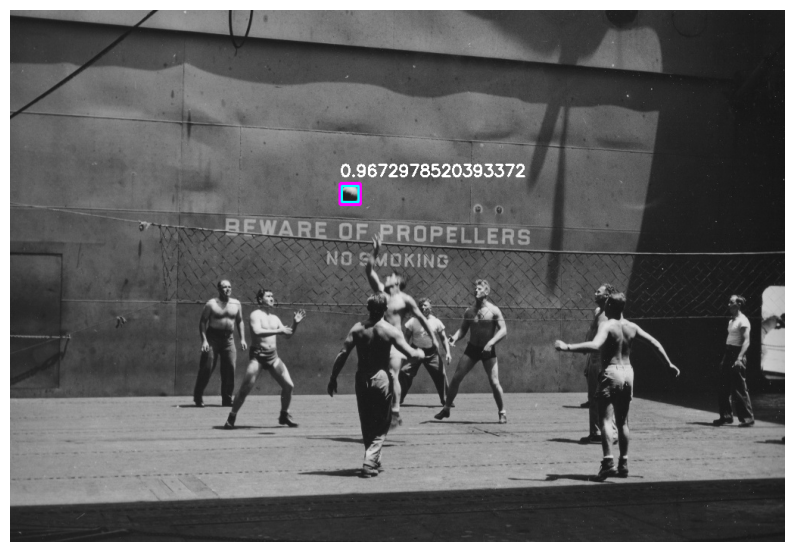

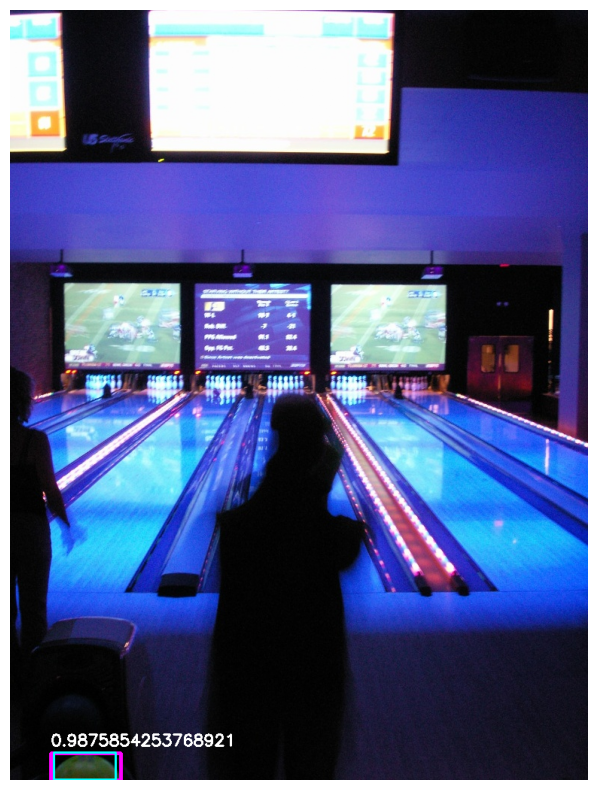

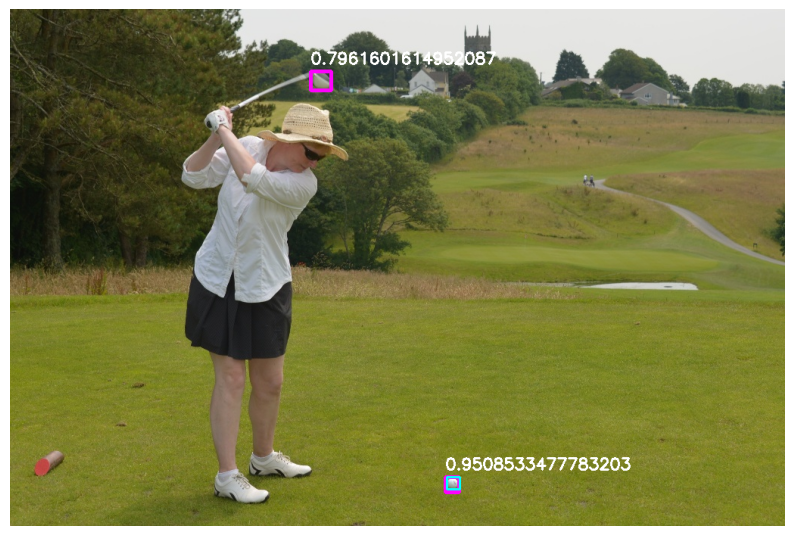

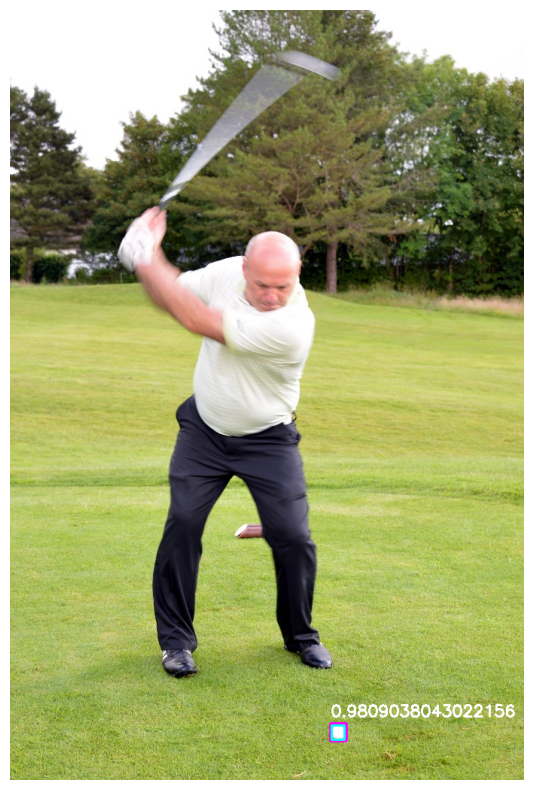

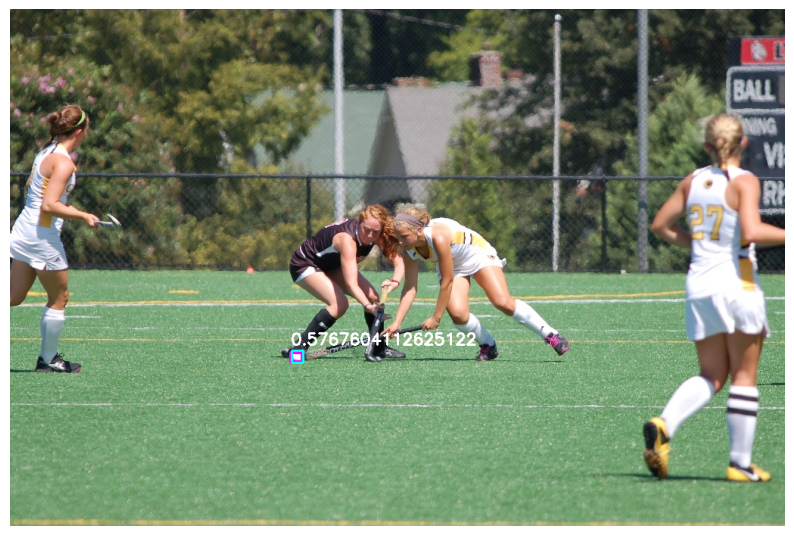

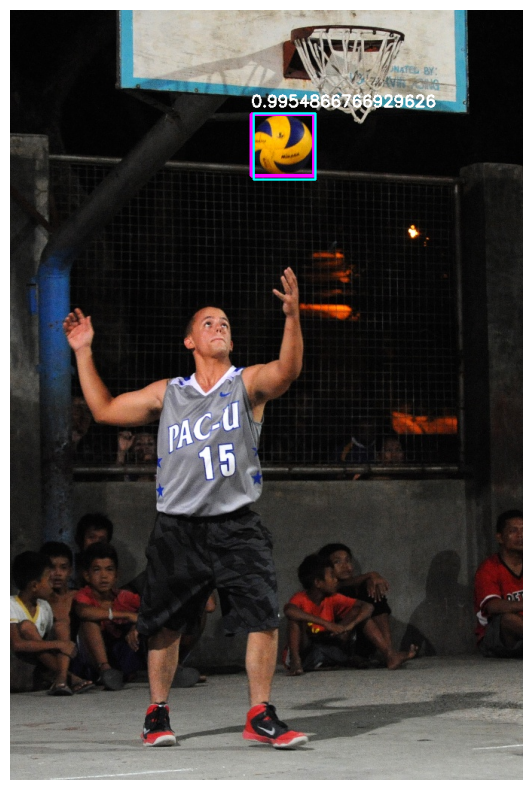

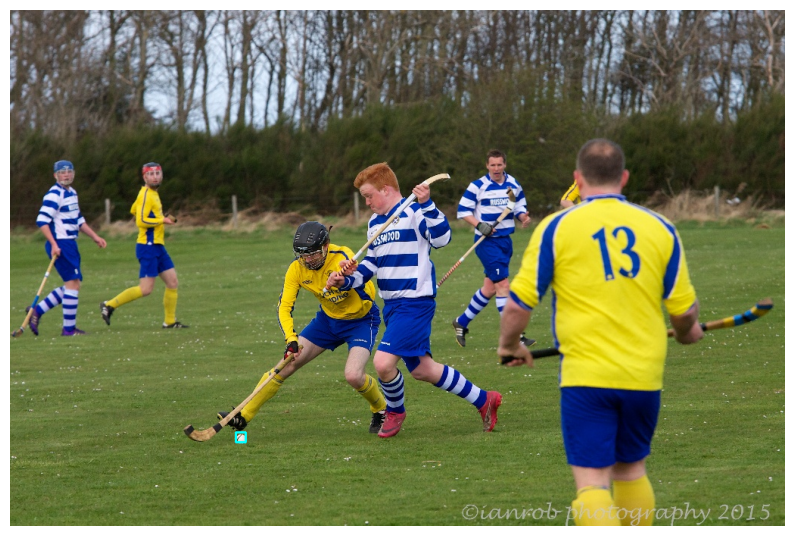

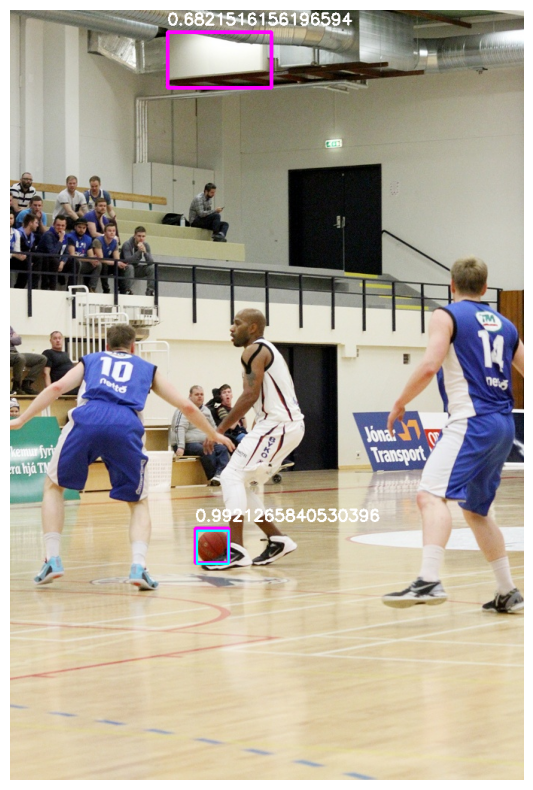

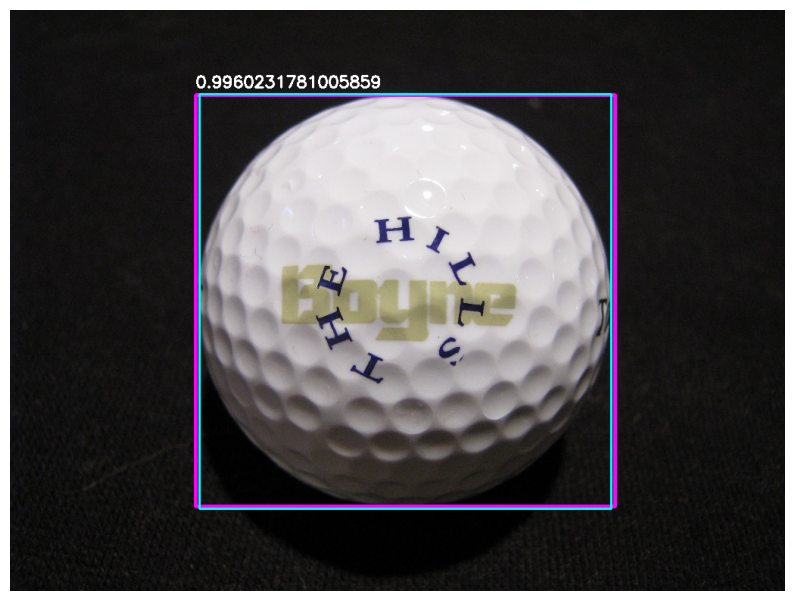

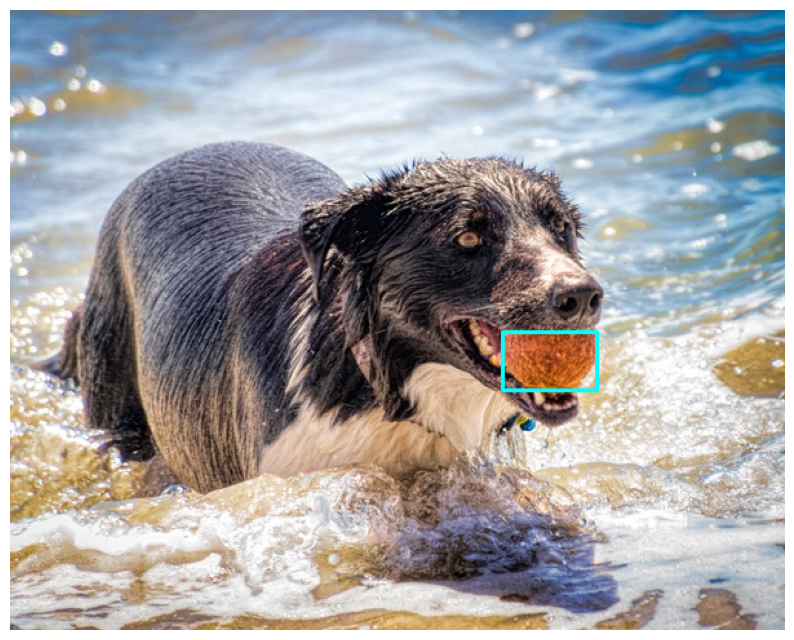

In [21]:
root_path = '/kaggle/input/oi5-ball'
val_file_path = '/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_val.json'

with open(val_file_path, 'r') as f:
    val_bboxes = json.load(f)

for key, value in val_bboxes.items():
    show_predictions_plate(os.path.join(root_path, key), value, model)

In [28]:
compute_mAP(val_data_loader, model)

  0%|          | 0/57 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/mean_average_precision/mean_average_precision_2d.py:64: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  self.match_table[c] = pd.concat([self.match_table[c], match_table], axis=0, join='outer')


0.00054826174

**mAP для модели без предобученного бекбоуна**

In [ ]:
pretrained_model_path = "/kaggle/input/io5_fastrcnn_4epoch/pytorch/1/2/model_not_ptretrained_without_aug.pth"

model = fasterrcnn_resnet50_fpn_v2(pretrained=False)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)

model.load_state_dict(torch.load(pretrained_model_path))
model.to(device)

In [30]:
compute_mAP(val_data_loader, model)

  0%|          | 0/57 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/mean_average_precision/mean_average_precision_2d.py:64: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  self.match_table[c] = pd.concat([self.match_table[c], match_table], axis=0, join='outer')


0.00034781624

**Посмотрим визуально на результаты не предобученной модели**

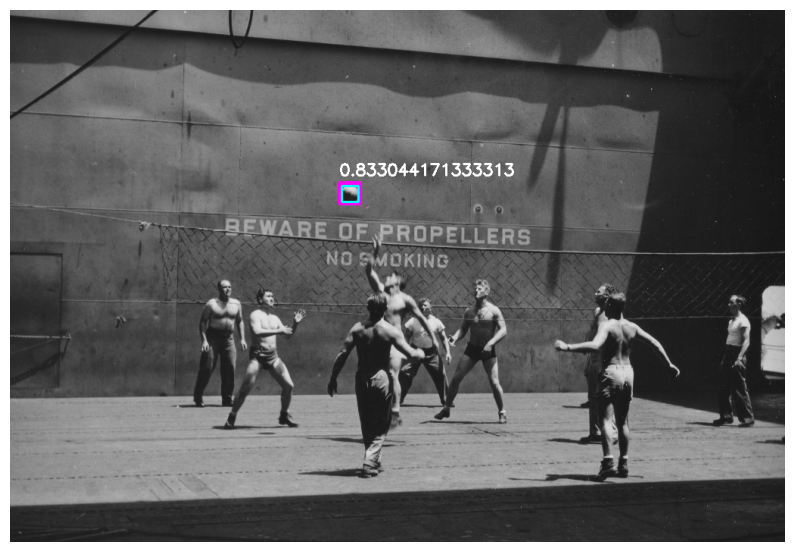

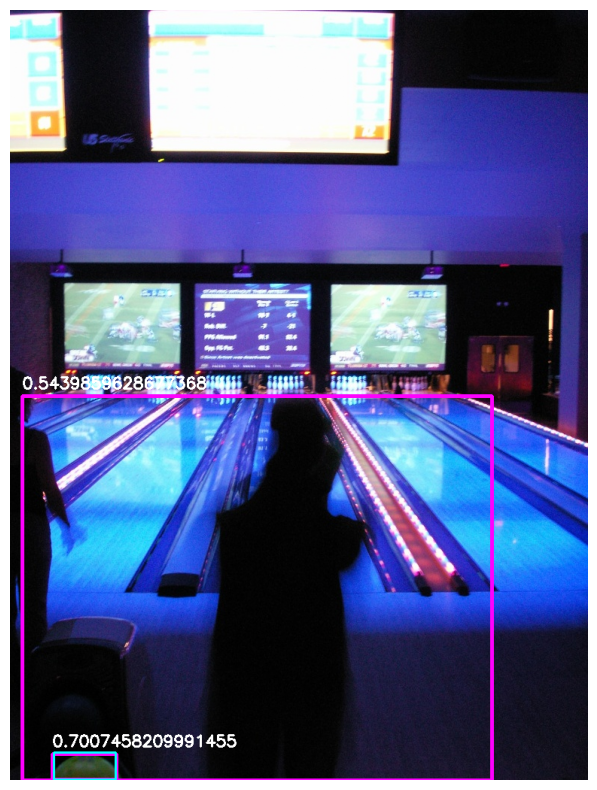

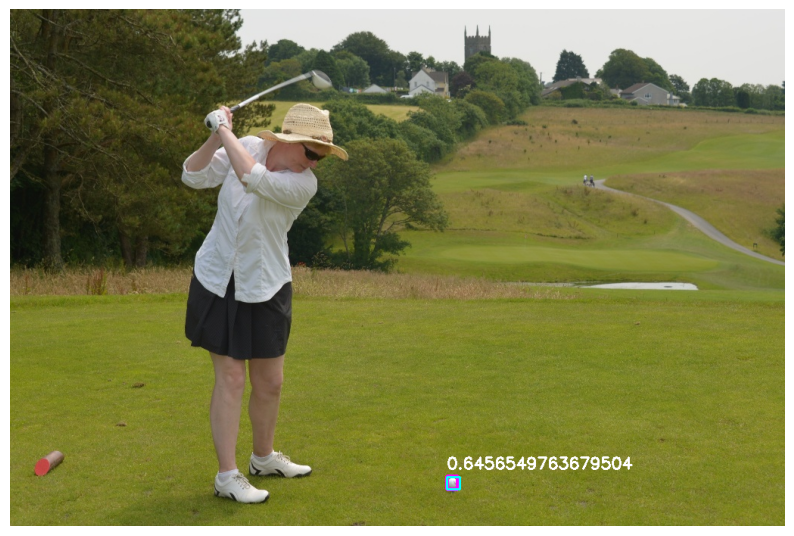

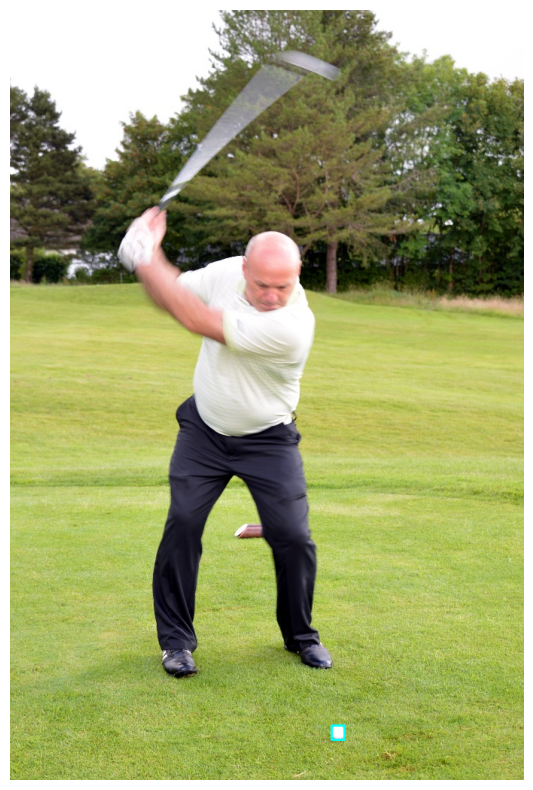

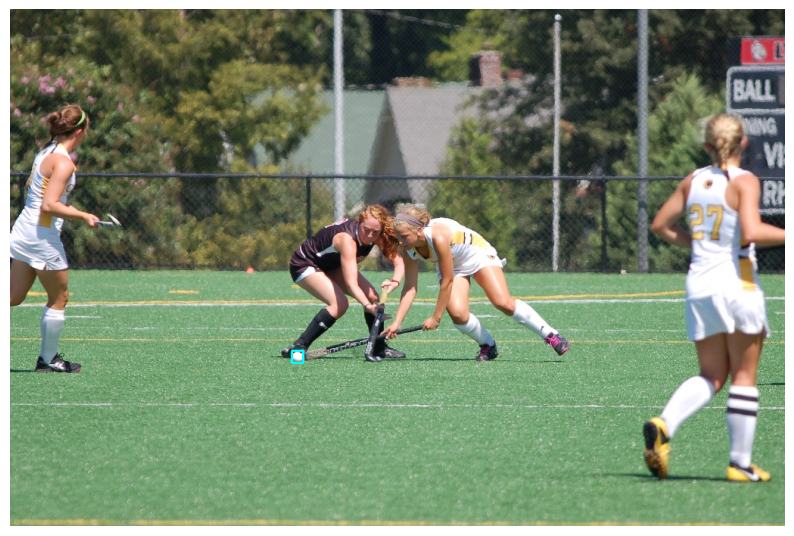

...

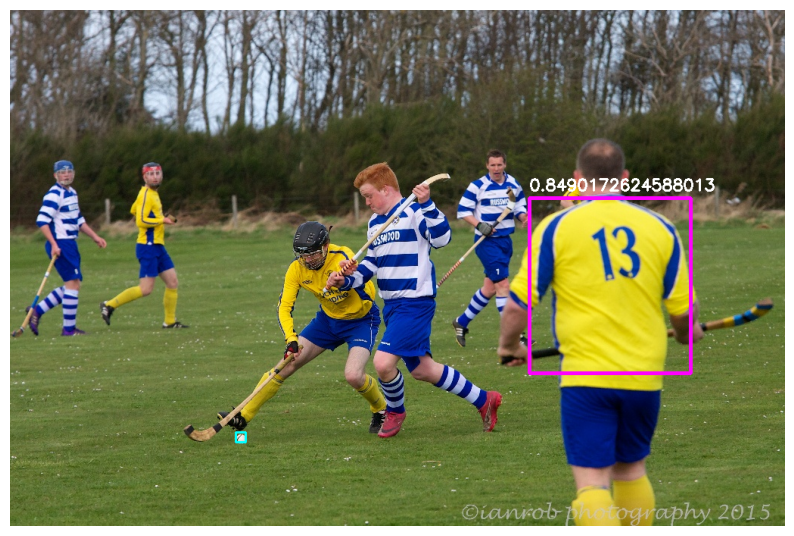

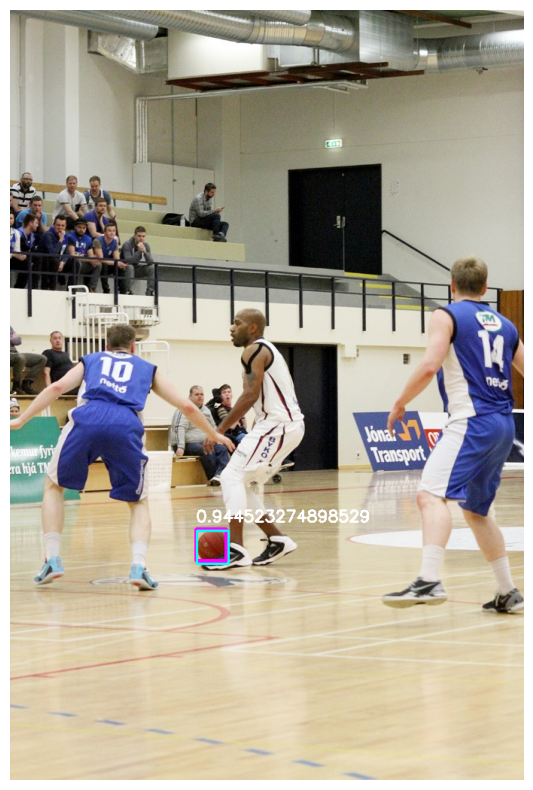

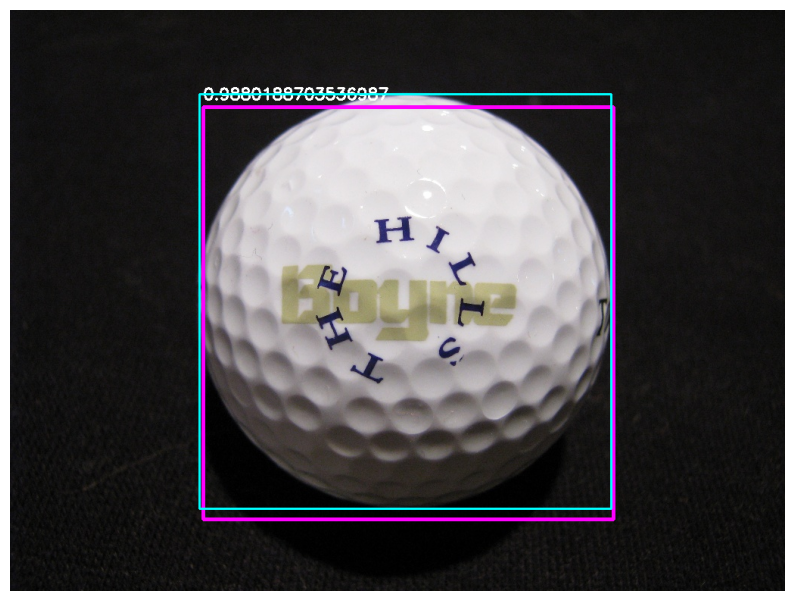

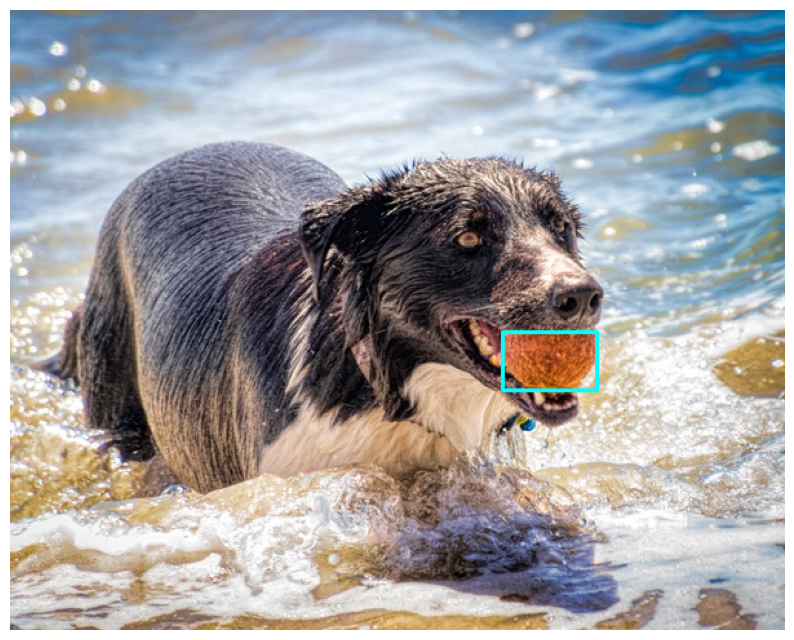

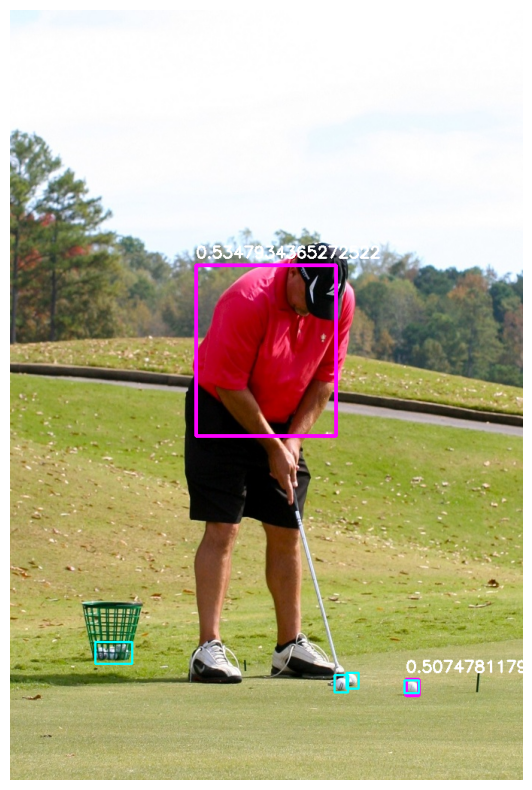

In [33]:
root_path = '/kaggle/input/oi5-ball'
val_file_path = '/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_val.json'

with open(val_file_path, 'r') as f:
    val_bboxes = json.load(f)


for key, value in val_bboxes.items():
    show_predictions_plate(os.path.join(root_path, key), value, model)

**Результаты предобученной модели с аугментациями**

In [44]:
pretrained_model_path = "/kaggle/input/io5_fastrcnn_4epoch/pytorch/1/2/model_ptretrained_with_aug.pth"

model = fasterrcnn_resnet50_fpn_v2(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)

model.load_state_dict(torch.load(pretrained_model_path))
model.to(device)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [45]:
compute_mAP(val_data_loader, model)

  0%|          | 0/57 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/mean_average_precision/mean_average_precision_2d.py:64: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  self.match_table[c] = pd.concat([self.match_table[c], match_table], axis=0, join='outer')


0.0071611316

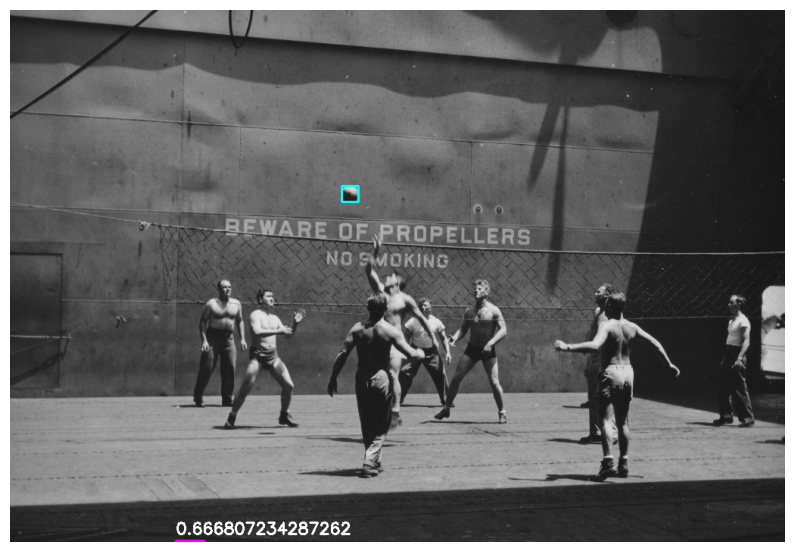

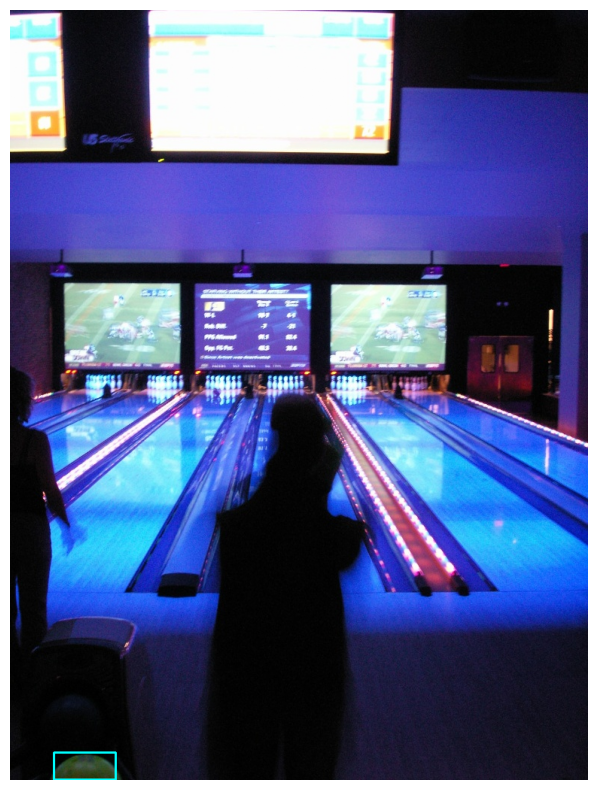

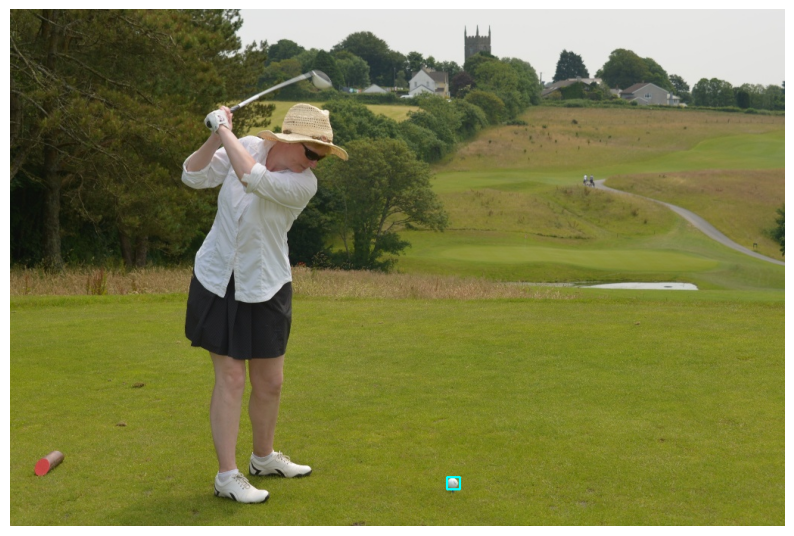

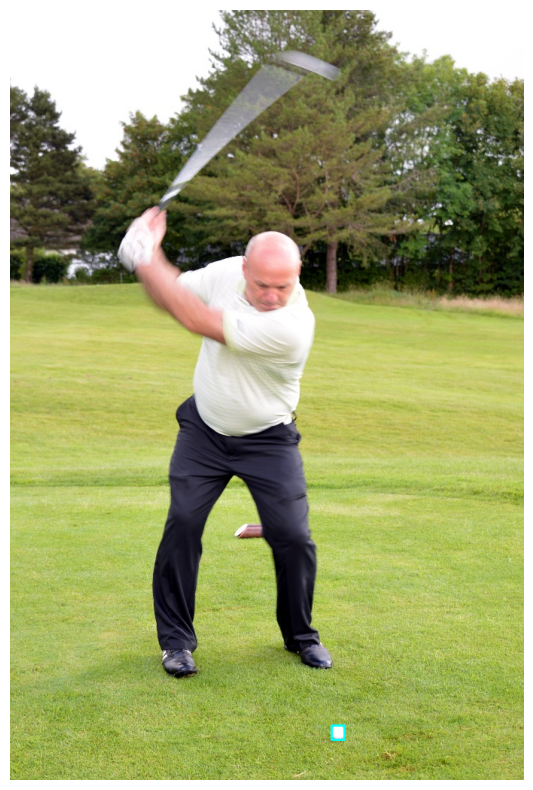

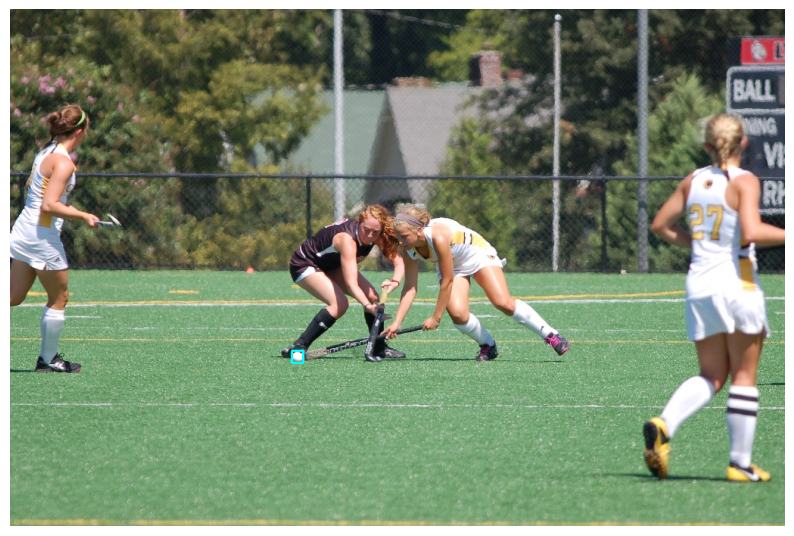

...

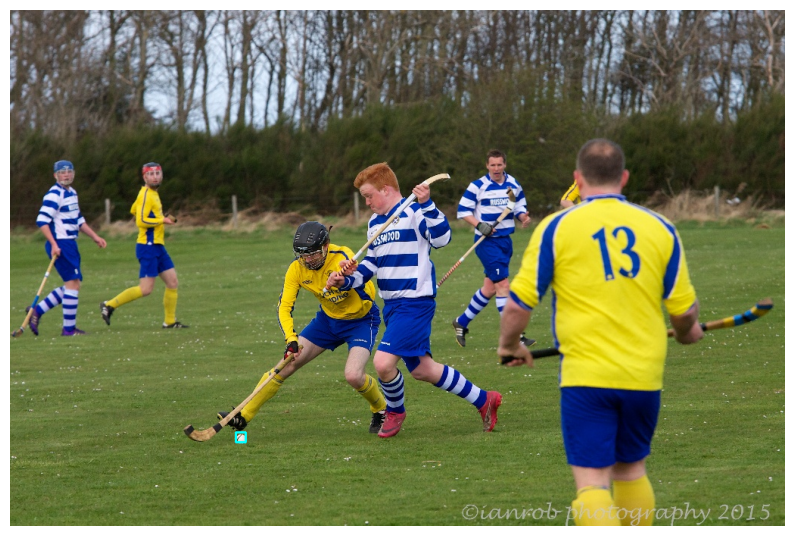

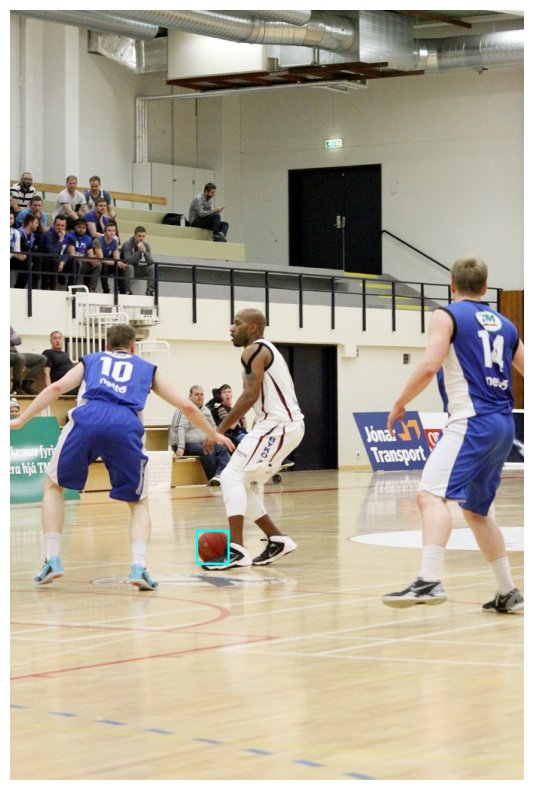

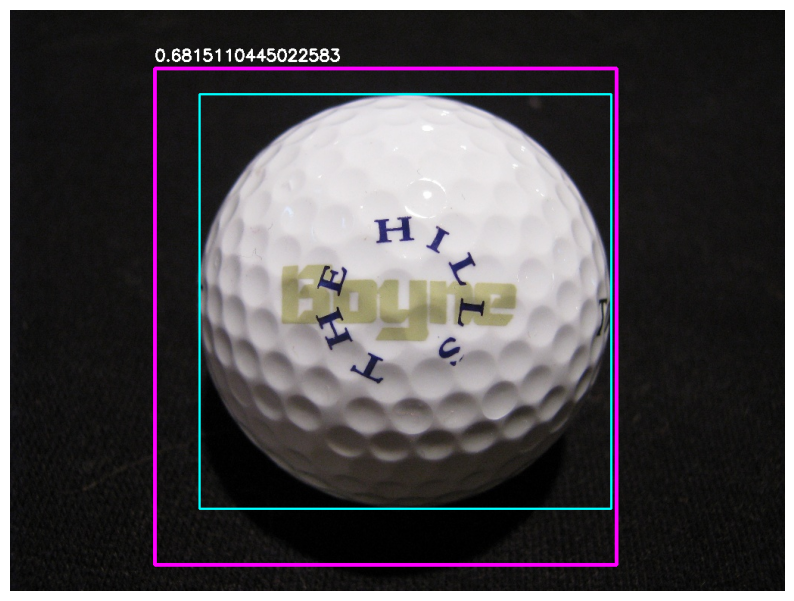

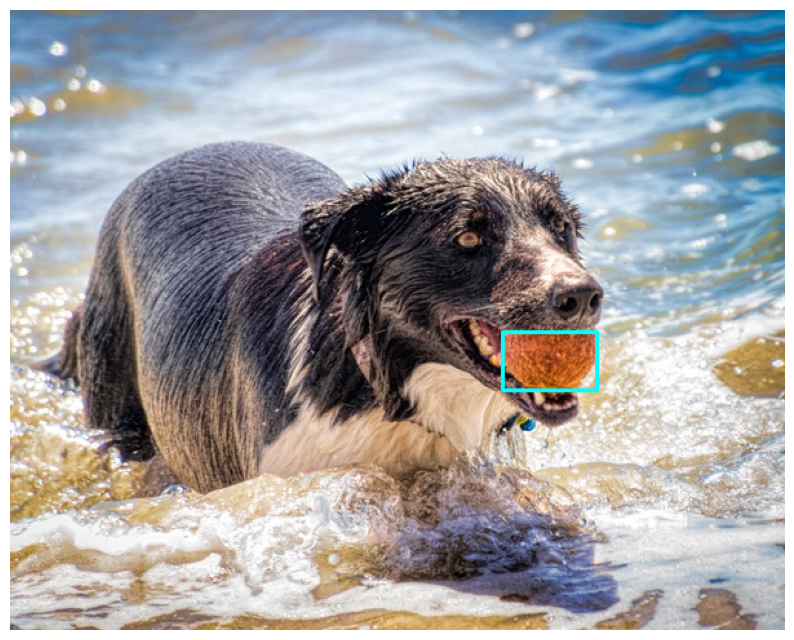

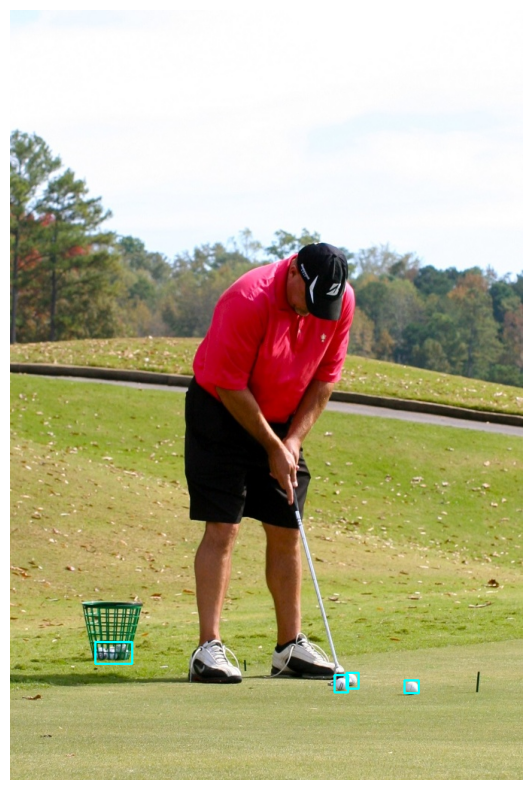

In [46]:
root_path = '/kaggle/input/oi5-ball'
val_file_path = '/kaggle/input/oi5-ball/oi5_ball_filename_to_bbox_val.json'

with open(val_file_path, 'r') as f:
    val_bboxes = json.load(f)


for key, value in val_bboxes.items():
    show_predictions_plate(os.path.join(root_path, key), value, model)

**Выводы**

Наилучший результат показала модель с предобученным backbone с добавлением аугментаций для изображений. Аугментации добавляют 25% к точности модели по метрике mAP. Хотя по первым 10 картинкам результаты у модели без аугментаций гораздо лучше.
Явные проблемы:
* Модель распознает "округлых" людей как мячи
* Модель плохо справляется с распознаванием мячей картинках, где их много. Модель может находить не все мячи, хотя размечены они одним bbox-ом.
* Модель плохо справляется с объектами, на которых есть засветы
* Модель плохо справляется с объектами, которые сливаются с фоном

Варианты как можно улучшить модель:
* Дообучить модель на большем количестве эпох (не пробовал больше 10, так как даже 10 эпох обучаются больше часа)
* Применить цветофильтры, чтобы сгладить засветы на картинках
* Применить кропы к изображению, чтобы научиться распознавать мячики на разной удаленности и разного размера